In [1]:
import numpy as np
import pandas as pd
import IPython
import re
import seaborn as sns
import matplotlib.pyplot as plt

import nltk
from nltk import sent_tokenize
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords 
from nltk.stem import WordNetLemmatizer
lemmatizer=WordNetLemmatizer()
from nltk.stem.porter import PorterStemmer

import string
import re

import wordcloud as WordCloud
from wordcloud import WordCloud

from textblob import TextBlob
from emot.emo_unicode import UNICODE_EMOJI # For emojis
from emot.emo_unicode import EMOTICONS_EMO # For EMOTICONSMH_ca


In [2]:
import sys
sys.path.insert(0, '../../_functions_')

from functions_EDA import *
from fx_NLP import *

In [3]:
df = pd.read_csv('../datasets/MH_Campaign_Tweets_Clean_1723.csv')

In [4]:
df['year'] = pd.DatetimeIndex(df['Date']).year

In [5]:
df_copy =df.copy()

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 724756 entries, 0 to 724755
Data columns (total 19 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   ID               724756 non-null  int64  
 1   Date             724756 non-null  object 
 2   url              724756 non-null  object 
 3   username         724756 non-null  object 
 4   source           724756 non-null  object 
 5   location         724756 non-null  object 
 6   tweet            724756 non-null  object 
 7   likes            724756 non-null  int64  
 8   rt               724756 non-null  int64  
 9   followers        724756 non-null  int64  
 10  replies          724756 non-null  int64  
 11  campaign         724756 non-null  object 
 12  likes_pf         724756 non-null  float64
 13  rt_pf            724756 non-null  float64
 14  replies_pf       724756 non-null  float64
 15  engagement       724756 non-null  float64
 16  engagement_0     724756 non-null  floa

In [14]:
import plotly.express as px

df_filtered = df[df['year'] != 2023]

# Create a dataframe with campaign counts and colors
df_campaign = pd.DataFrame({
    'campaign': ['ED (non-EDAW)', 'EDAW'],
    'counts': [4250, 2075],
    'colors': ['#71C4C0', '#953D8C']
})

fig = px.pie(df_campaign, values='counts', names='campaign', color='colors',
             color_discrete_sequence=df_campaign['colors'], hole=.6,
             custom_data=[df_campaign['campaign'].value_counts().apply(lambda x: f"{x:,}").tolist(), ['tweets', 'tweets']])
fig.update_traces(textposition='inside', textinfo='percent', 
                  hovertemplate='%{label}: %{percent}<br>Tweets: %{customdata[0]}')
fig.update_layout(
    width=800, 
    height=600,
    margin=dict(t=100, l=0, r=0, b=0),
    hoverlabel=dict(bgcolor="white", font_size=12, font_family="Arial"),
    title={"text": "Tweets about Eating Disorders, 1st of January 2017 to 31st December 2022",
           "y":0.95, "x":0.5, "xanchor": "center", "yanchor": "top"}
)
fig.show()

In [15]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 724756 entries, 0 to 724755
Data columns (total 19 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   ID               724756 non-null  int64  
 1   Date             724756 non-null  object 
 2   url              724756 non-null  object 
 3   username         724756 non-null  object 
 4   source           724756 non-null  object 
 5   location         724756 non-null  object 
 6   tweet            724756 non-null  object 
 7   likes            724756 non-null  int64  
 8   rt               724756 non-null  int64  
 9   followers        724756 non-null  int64  
 10  replies          724756 non-null  int64  
 11  campaign         724756 non-null  object 
 12  likes_pf         724756 non-null  float64
 13  rt_pf            724756 non-null  float64
 14  replies_pf       724756 non-null  float64
 15  engagement       724756 non-null  float64
 16  engagement_0     724756 non-null  floa

In [16]:
df.iloc[310814,:].tweet

'We want to spread some kindness EVERYDAY of the week in support of #MentalHealthAwarenessWeek ✨ For the chance to #WIN a Pretty Little Parcel, all you have to do is: follow us then tweet the hashtag #LovePLT 💕 and remember, be kind always 💘'

In [21]:
df.iloc[310814,:].processed_tweet
#can see that the function which processed the tweets has returned them as a list of tokens.

'want spread kindness everyday week support mentalhealthawarenessweek chance win pretty little parcel follow us tweet hashtag loveplt remember kind always'

In [22]:
#selecting just the EDAW tweets, whch have been cleaned
EDAW_tweets = df[df['campaign']=='EDAW']['processed_tweet']

In [23]:
EDAW_tweets = [str(tweet) for tweet in EDAW_tweets]

In [24]:
EDAW_tweets

['eating disorders awareness week one still acutely aware presence eatingdisorders life would like confine awareness one week year someone could sort',
 'tulyrq thats okay',
 'tulyrq yikes',
 'even care nah fine',
 'preset green pink primary',
 'amazing keep',
 'sorry',
 'gl man hit subs march never forget',
 'mindcharity wrote blog post experiences edaw last year good well informed gp make difference https',
 'excerpts booklet edaw made stories poems art people living lived experience read full https https',
 'diversity family experiences recording available https thanks ken maura hayes harrietparsons caredireland caredscork ldceds saramcdevitt https',
 'mp speaks eating disorders awareness week carolyn harris chair westminster hall debates https https',
 'mp speaks eating disorders awareness week carolyn harris chair westminster hall debates https https',
 'teamaresggs would much would like added list',
 'literall shit twitter account bc whole point actual content goodnight',
 'damn 

In [25]:
#joining all the tweets together in one big quote, ready for the wordcloud
joined_tweets = " ".join(EDAW_tweets)

In [26]:
list_words = ['edaw', 'eating', 'disorders', 'disorder','eatingdisorders','eatingdisorderawarenessweek',
                   'awareness','week','amp','http','https', 'MentalHealthAwarenessWeek', 'mental', 
              'health', 'day', 'uni', 'umhd', 'universitymentalhealthday', 'unimentalhealthday','ocd','ocdweek']

In [27]:
word_cloud_stopwords=set(stopwords.words('english'))
word_cloud_stopwords.update(list_words)

(-0.5, 599.5, 399.5, -0.5)

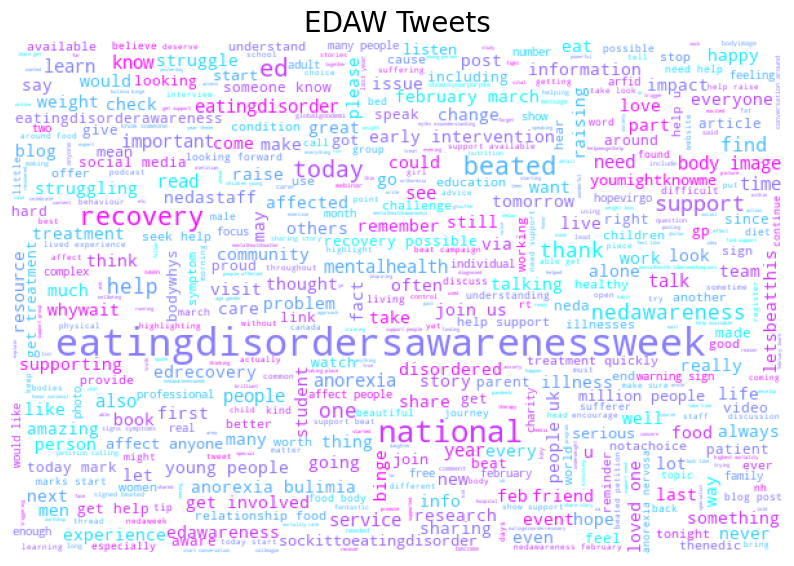

In [28]:
# EDAW Tweets
plt.figure(figsize=(10,10))

wc = WordCloud(width=600,
               height=400,background_color='white',       
               max_words=10000, 
               stopwords=word_cloud_stopwords
               , max_font_size= 30)

wc.generate(joined_tweets)
plt.title("EDAW Tweets", fontsize=20)
# plt.imshow(wc.recolor( colormap= 'Pastel1_r' , random_state=17), alpha=0.98)
plt.imshow(wc.recolor( colormap= 'cool' , random_state=17), alpha=0.98)
plt.axis('off')

#need to update the stop words with the words I used to search for the tweets, because atm, that's all it's showing!

In [29]:
df.info()
#checking year variable is in the df

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 724756 entries, 0 to 724755
Data columns (total 19 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   ID               724756 non-null  int64  
 1   Date             724756 non-null  object 
 2   url              724756 non-null  object 
 3   username         724756 non-null  object 
 4   source           724756 non-null  object 
 5   location         724756 non-null  object 
 6   tweet            724756 non-null  object 
 7   likes            724756 non-null  int64  
 8   rt               724756 non-null  int64  
 9   followers        724756 non-null  int64  
 10  replies          724756 non-null  int64  
 11  campaign         724756 non-null  object 
 12  likes_pf         724756 non-null  float64
 13  rt_pf            724756 non-null  float64
 14  replies_pf       724756 non-null  float64
 15  engagement       724756 non-null  float64
 16  engagement_0     724756 non-null  floa

In [32]:
# campaign, year, and stop words as parameters.
def campaign_wordcloud(df,campaign_name,desired_year, remove_words_list, dpi=300):

#ensure necessary library is included
    from wordcloud import WordCloud
    import matplotlib.pyplot as plt
#select the tweets by campaign and year
    tweets = df[(df['campaign']==campaign_name)&(df['year']==desired_year)]['processed_tweet']
#convert the tweets into one long string    
    string = [str(tweet) for tweet in tweets]
#join all tweet words together into one quote
    joined_tweets = " ".join(string)
#words that should be removed
    words_to_remove = set(remove_words_list)
# Generate the wordcloud, excluding the words in remove_words_list
    plt.figure(figsize=(30,30), dpi=dpi)
    wc = WordCloud(width=600,
                   height=400,background_color="white", 
                   max_words=10000, stopwords=remove_words_list, max_font_size= 60)
    word_cloud_stopwords.update(remove_words_list)
    wc.generate(joined_tweets)
    plt.title(campaign_name + " " + str(desired_year), fontsize=30)
    plt.imshow(wc.recolor( colormap= 'cool' , random_state=17), alpha=0.98)
    plt.axis('off')
    #plt.savefig(f"{campaign_name}_{desired_year}_wordcloud.png", dpi=dpi, bbox_inches='tight')
    plt.show()

In [39]:
words_to_remove = ['edawareness','people','binge','bingeeating','anorexia','support','Anorexia','Bulimia', 'bulimia',
             'Nervosa','nervosa','recovery','hope','edrecovery','nedastaff','ed', 'national','eatingdisorder',
             'beated','mentalhealth','nedawareness', 'disordered', 'eatingdisorderawareness','Eds'
             'eatingdisordersawarenessweek','edaw','eating', 'disorders', 'february','march',
             'disorder','eatingdisorders','eatingdisorderawarenessweek','eatingdisordersawarenessweek',
                   'awareness','week','amp','http','https', 'MentalHealthAwarenessWeek', 'mental', 
              'health', 'day', 'uni', 'umhd', 'universitymentalhealthday', 'unimentalhealthday','ocd','ocdweek']

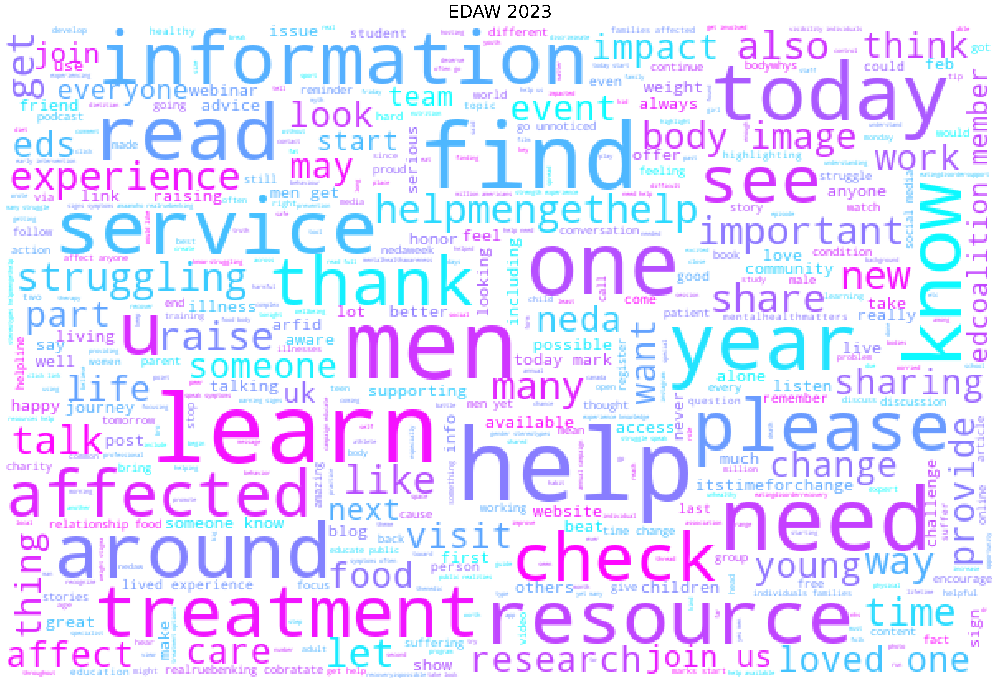

In [34]:
campaign_wordcloud(df,'EDAW', 2023, words_to_remove)

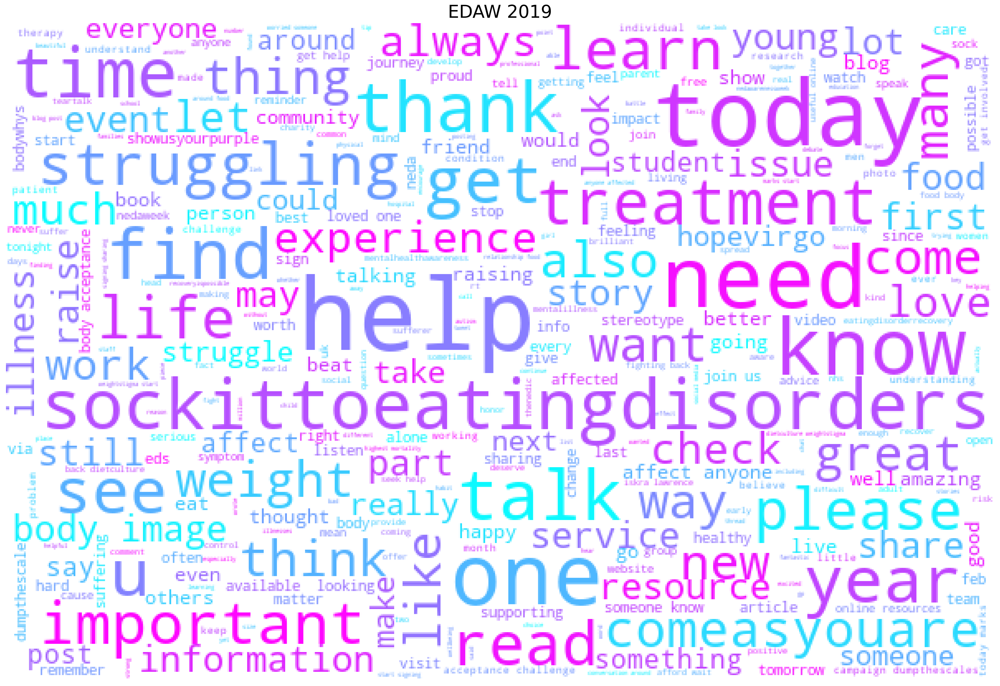

In [45]:
campaign_wordcloud(df,'EDAW', 2019, words_to_remove)

In [50]:
# Filter the dataframe to include only ED and EDAW campaigns
df_ed = df[df['campaign'].isin(['ED', 'EDAW'])]

# Find all tweets containing the word 'men'
regex = r'\b(men|man|boys|male)\b'
df_ed_men = df_ed[df_ed['tweet'].str.contains(regex, flags=re.IGNORECASE)]

# Convert the date column to datetime format
df_ed_men['Date'] = pd.to_datetime(df_ed_men['Date'])

# Group the tweets by week and count the number of tweets per week
df_count = df_ed_men.groupby(['campaign', pd.Grouper(key='Date', freq='W')]).size().reset_index(name='count')

# Create an interactive line plot using plotly
fig = px.line(df_count, x='Date', y='count', color='campaign', 
              title='Number of Tweets per Week about Men and Eating Disorders',
              color_discrete_sequence=['#71C4C0','#972886'], 
              labels={'campaign': 'Campaign', 'count': 'Number of Tweets'})

# Change the label of ED campaign in the legend
fig.update_traces(name='ED (non-EDAW)', selector=dict(name='ED'))

fig.update_layout(
    xaxis=dict(title='Time Period'),
    yaxis=dict(title='Number of Tweets'),
    hovermode='x unified',
    plot_bgcolor='rgba(0,0,0,0)',
    title_x=0.5
)
fig.show()

In [51]:
#looking at non-EDAW ED tweet spike about men:
# Convert the date column to datetime format
df['Date'] = pd.to_datetime(df['Date'])

# Filter the dataframe to include only tweets from July 30th 2017
df_2017_07_30 = df.loc[df['Date'].dt.date == pd.to_datetime('2017-07-30').date()]

# View the filtered dataframe
df_2017_07_30.tweet.tolist()

#can see from this that people are talking about men and EDs because of panorama documentary

['The objective of Mental Health Awareness Week is to cultivate a culture of acceptance, raise awareness and... https://t.co/Cu225sQq7G',
 '.@JonahNRO mental health awareness week',
 '5 Truths About Eating Disorders the Stereotypes Don’t Show @TheMightySite. #eatingdisorders #mentalhealth https://t.co/hY7PAtm1Rd https://t.co/OedtVTsMmw',
 'Please check out my story @headsashed55 https://t.co/3UkMQHcRVC #mentalhealth #survivor #eatingdisorders',
 '@jamesldowns , came across this recent study about #EatingDisorders in #Men by @EDsJTP - #mental #health #recovery https://t.co/msyGWtG5Yi',
 'New #EDsJTP! Perceptions of disordered eating &amp; associated help seeking in young women: https://t.co/eSTRezja5N. // #EatingDisorders',
 'New #EDsJTP! Psychopathology &amp; expressed emotion in parents of ppl w/ #EatingDisorders &amp; ED symptom severity: https://t.co/r8i1RftEo1.',
 'Why Gyms Need To Be More Aware Of People With Eating Disorders - Adios Barbie https://t.co/Ep2AOOGigk #eatingdisorders

In [52]:
df_2017_07_30.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 29 entries, 6783 to 683185
Data columns (total 19 columns):
 #   Column           Non-Null Count  Dtype              
---  ------           --------------  -----              
 0   ID               29 non-null     int64              
 1   Date             29 non-null     datetime64[ns, UTC]
 2   url              29 non-null     object             
 3   username         29 non-null     object             
 4   source           29 non-null     object             
 5   location         29 non-null     object             
 6   tweet            29 non-null     object             
 7   likes            29 non-null     int64              
 8   rt               29 non-null     int64              
 9   followers        29 non-null     int64              
 10  replies          29 non-null     int64              
 11  campaign         29 non-null     object             
 12  likes_pf         29 non-null     float64            
 13  rt_pf          

In [53]:
df_2017_07_30.likes.sort_values(ascending=False)

683183    9
683163    5
683162    4
683172    3
683168    3
6783      2
683167    2
683176    2
683161    1
683177    1
683181    1
683175    0
683180    0
683182    0
683179    0
683178    0
683184    0
683171    0
683174    0
683173    0
6784      0
683170    0
683169    0
683166    0
683165    0
683164    0
683160    0
683159    0
683185    0
Name: likes, dtype: int64

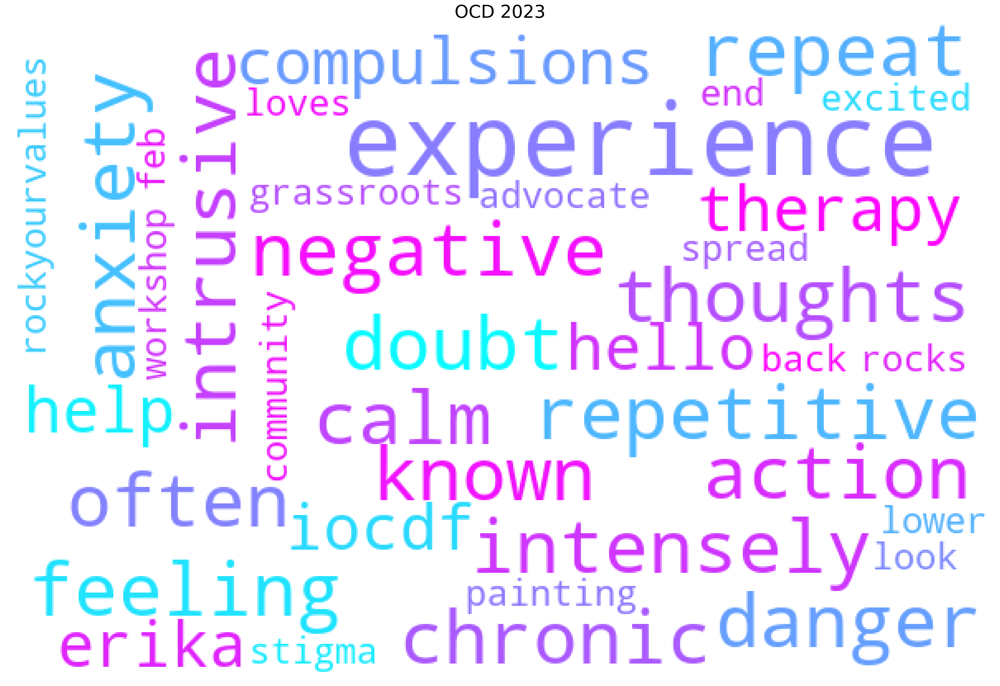

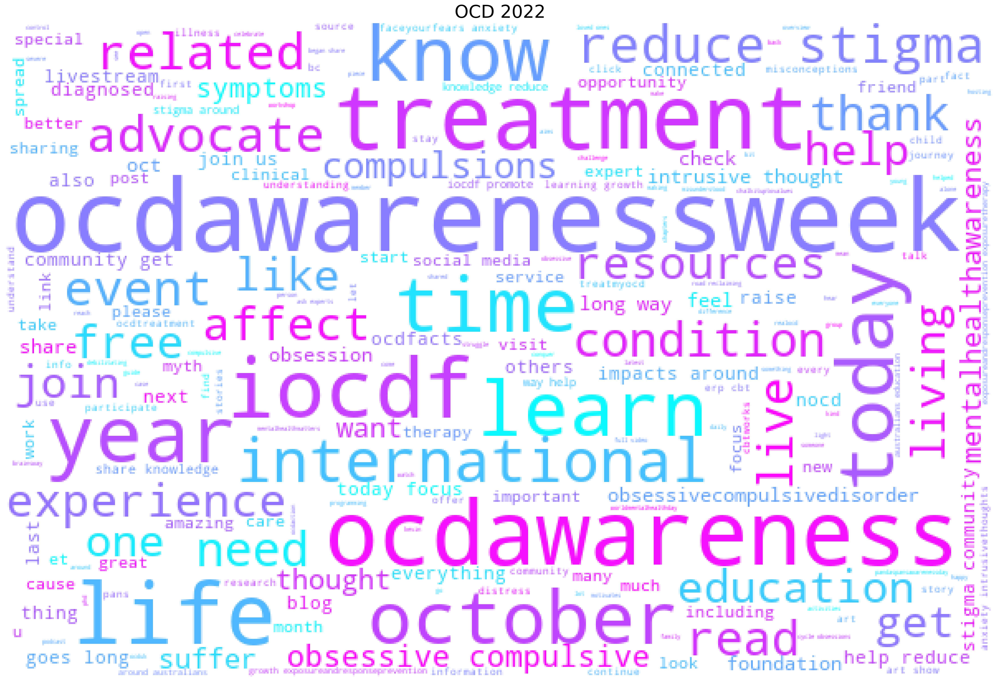

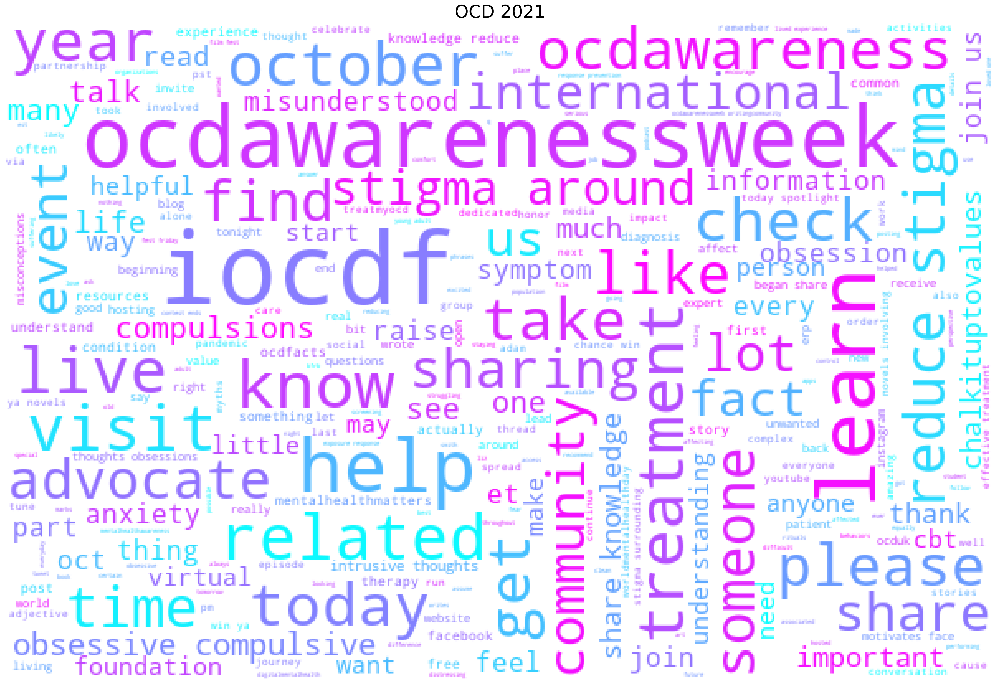

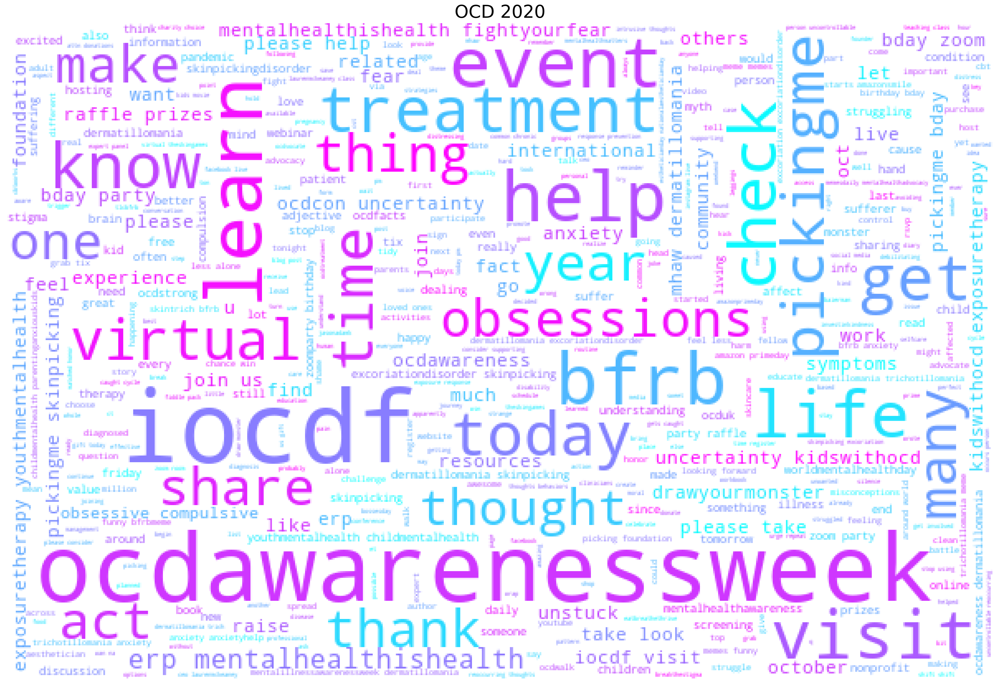

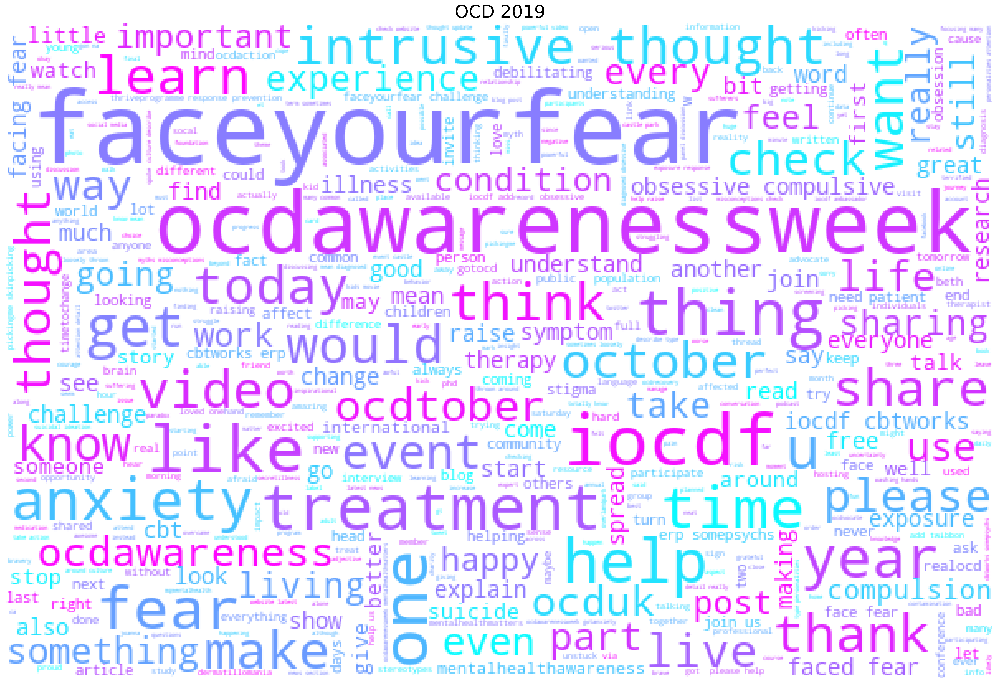

...

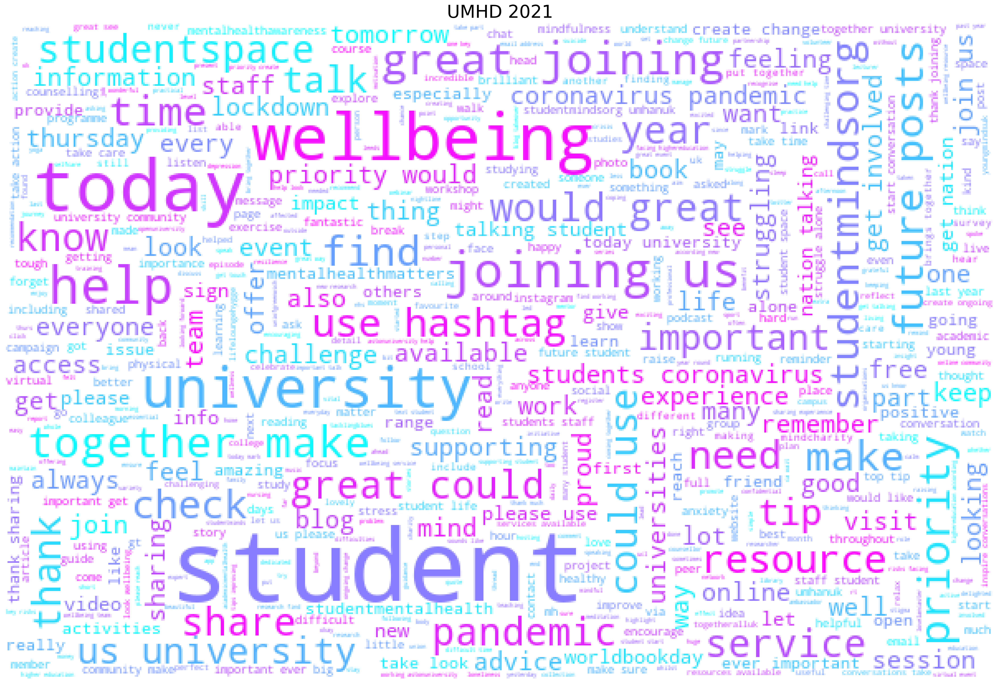

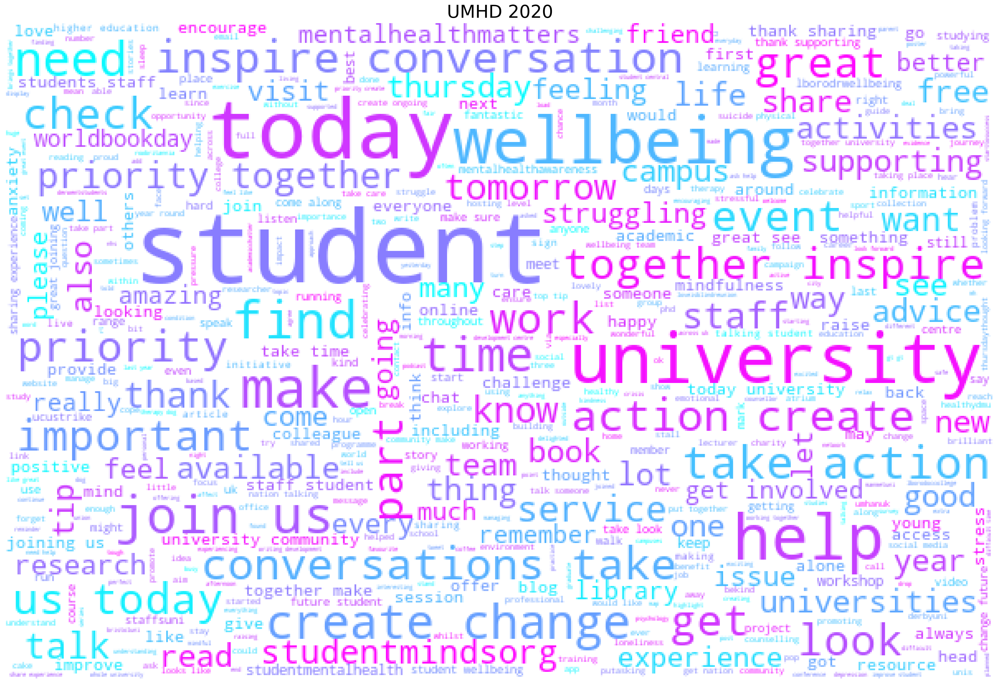

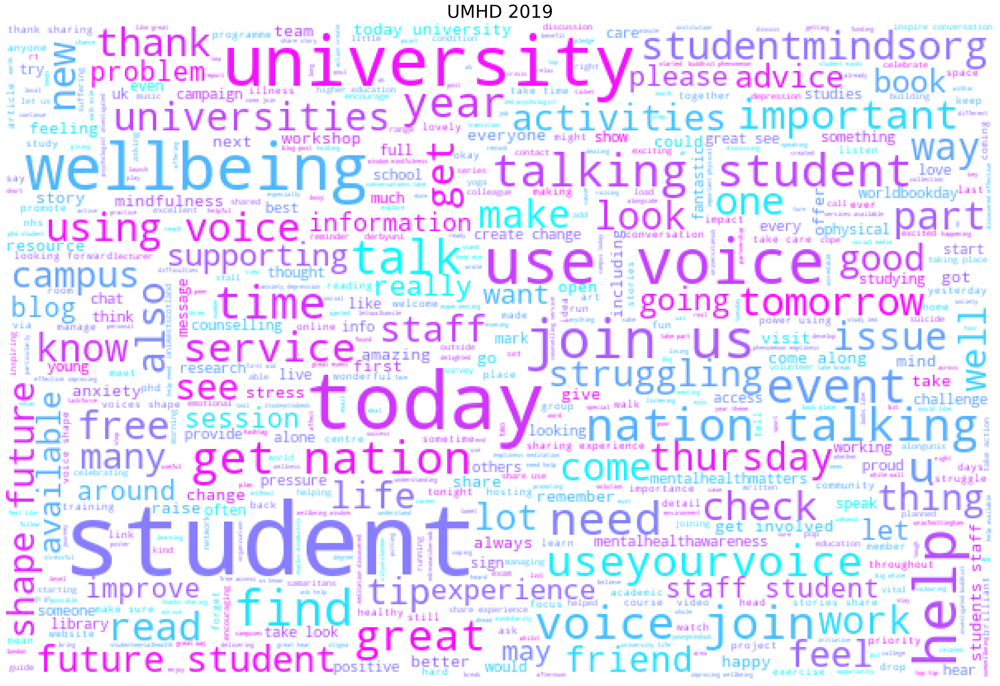

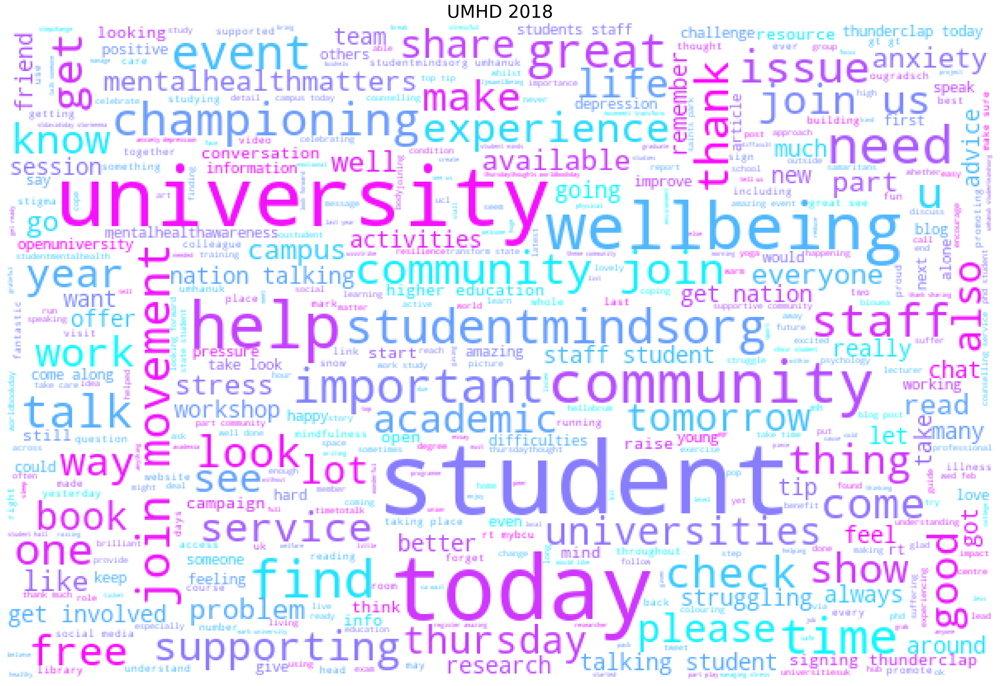

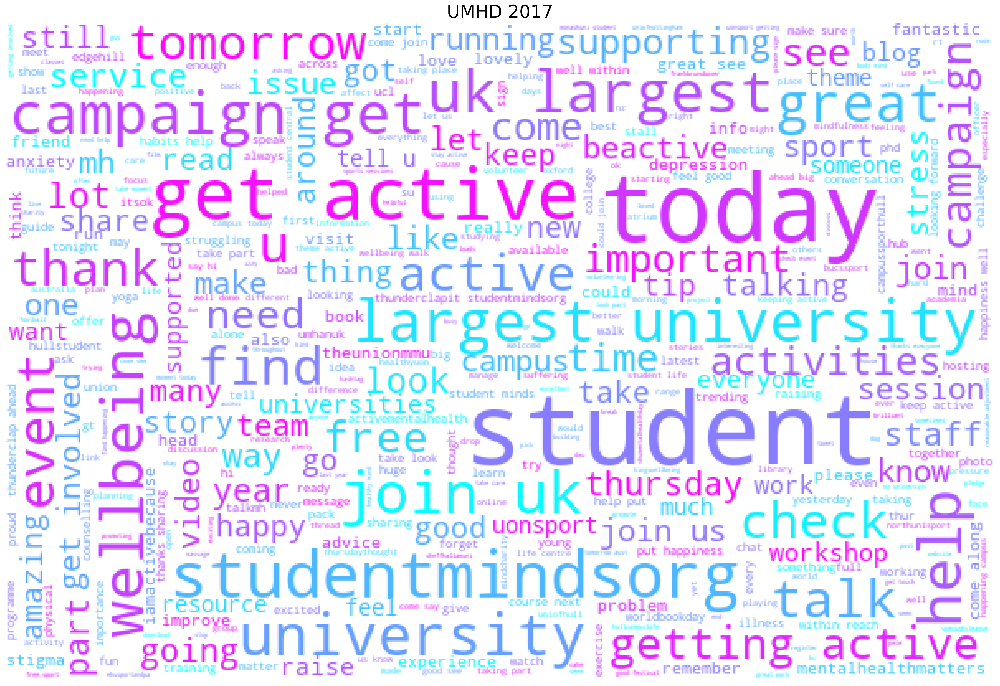

In [68]:
#creating a for-loop that will make a wordcloud for each year
# campaigns and years to generate wordclouds for
#.unique gets a list of the available names and years from the df
campaigns = df['campaign'].unique()
years = df['year'].unique()

# remove_words_list to use for all wordclouds
remove_words_list = words_to_remove

# generate wordcloud for each campaign and year combination
for campaign in campaigns:
    for year in years:
        campaign_wordcloud(df, campaign, year, words_to_remove)

In [ ]:
#further words to remove:
#'ocdawarenessweek','ocdawareness','mentalhealthawareness','international','iocdf','u','like','also','get','could',
#'studentmindsorg' 

In [ ]:
words_to_remove = ['nedastaff','ed','national','eatingdisorder','beated','mentalhealth','nedawareness','eatingdisordersawarenessweek','edaw','eating', 'disorders', 'disorder','eatingdisorders','eatingdisorderawarenessweek',
                   'awareness','week','amp','http','https', 'MentalHealthAwarenessWeek', 'mental', 
              'health', 'day', 'uni', 'umhd', 'universitymentalhealthday', 'unimentalhealthday','ocd','ocdweek',
            'ocdawarenessweek','ocdawareness','mentalhealthawareness','international','iocdf','u','like','also',
             'get','could','studentmindsorg']

# Save the emoji! (final tweet preprocessing)

In [69]:
#VADER analysis is able to take emojis and punctuation. Therefore, I am going to make a column that retains these so that
#we can run the analysis on with and without to compare sentiment scores, and have the ability to plot the emojis as well
import re
from nltk.corpus import stopwords
def clean_tokens(text, language):
    # create tokens
    tokens = word_tokenize(text)
    # lower case
    tokens = [w.lower() for w in tokens]
    # remove stop_words
    stop_words = set(stopwords.words(language))
    words = [w for w in tokens if not w in stop_words]
    # remove tokens that contain digits using regular expressions
    words = [re.sub('\d+', '', w) for w in words]
    # join cleaned tokens into a single string
    clean_text = ' '.join(words)
    # return the cleaned string
    return clean_text

In [70]:
test_tweet='We want to spread some kindness EVERYDAY of the week in support of #MentalHealthAwarenessWeek ✨ For the chance to #WIN a Pretty Little Parcel, all you have to do is: follow us then tweet the hashtag #LovePLT 💕 and remember, be kind always 💘'

In [71]:
clean_tokens(test_tweet,'english')

'want spread kindness everyday week support # mentalhealthawarenessweek ✨ chance # win pretty little parcel , : follow us tweet hashtag # loveplt 💕 remember , kind always 💘'

In [ ]:
# Apply to original tweets
df['tweet_emoji_punc'] = df.tweet.apply(lambda x: clean_tokens(x,'english'))

In [ ]:
df.drop(columns=['tweet_emojis_punc'], inplace=True)

In [ ]:
df.head()

In [ ]:
def get_tweet_versions(df,index):
    original_tweet=df.iloc[index,:].tweet
    processed_tweet=df.iloc[index,:].processed_tweet
    tokenised_tweet=df.iloc[index,:].tokenised_tweet
    tweet_emoji_punc=df.iloc[index,:].tweet_emoji_punc
    
    return{'original_tweet': original_tweet,
           'processed_tweet': processed_tweet,
           'tokenised_tweet': tokenised_tweet,
           'tweet_emoji_punc': tweet_emoji_punc}

In [ ]:
get_tweet_versions(df,310819)
#can see that tokenised and processed are the same as each other, so will need to apply tokenisation again.

In [ ]:
df.drop(columns=['tokenised_tweet'], inplace=True)

In [ ]:
from nltk.tokenize import word_tokenize

df['tokenised_tweet'] = df.processed_tweet.apply(word_tokenize)

In [ ]:
get_tweet_versions(df,310819)

In [ ]:
#for now, saving current df to a csv so we don't have to run the above again.
#we added year, deleted nulls, and saved the emojis as the final step here

#df.to_csv('MH_Campaign_Tweets_Tokenised_1723', index=False)

In [74]:
# Import necessary libraries
import pandas as pd
import plotly.express as px

# Calculate the number of tweets per year by campaign
df_count = df.groupby(['year', 'campaign']).size().reset_index(name='count')

# Create an interactive bar plot using plotly
fig = px.line(df_count, x='year', y='count', color='campaign', title='Number of Tweets by Year and Campaign')
fig.update_layout(
    xaxis=dict(type='category', title='Year', tickmode='linear'),
    yaxis=dict(title='Number of Tweets'),
    hovermode='x unified',
    legend=dict(title='Campaign'),
    plot_bgcolor='rgba(0,0,0,0)',
    clickmode='event+select'
)
fig.show()

In [75]:
# Import necessary libraries
import pandas as pd
import plotly.express as px

# Calculate the number of tweets per year by campaign
df_count = df.groupby(['year', 'campaign']).size().reset_index(name='count')

# Create an interactive bar plot using plotly
fig = px.bar(df_count, x='year', y='count', color='campaign', title='Number of Tweets by Year and Campaign')
fig.update_layout(
    xaxis=dict(type='category', title='Year', tickmode='linear'),
    yaxis=dict(title='Number of Tweets'),
    hovermode='x unified',
    legend=dict(title='Campaign'),
    plot_bgcolor='rgba(0,0,0,0)',
    clickmode='event+select'
)
fig.show()

In [76]:
# Filter out the rows with year equal to 2023 - because the graphs above are skewed where MHAW and OCD haven't happened yet
df = df[df['year'] != 2023]

# Calculate the number of tweets per year by campaign
df_count = df.groupby(['year', 'campaign']).size().reset_index(name='count')

# Create an interactive bar plot using plotly
fig = px.bar(df_count, x='year', y='count', color='campaign', title='Number of Tweets by Year and Campaign')
fig.update_layout(
    xaxis=dict(type='category', title='Year', tickmode='linear'),
    yaxis=dict(title='Number of Tweets'),
    hovermode='x unified',
    legend=dict(title='Campaign'),
    plot_bgcolor='rgba(0,0,0,0)',
    clickmode='event+select'
)
fig.show()

In [77]:
# Filter out the rows with year equal to 2023 - because the graphs above are skewed where MHAW and OCD haven't happened yet
df = df[df['year'] != 2023]

# Calculate the number of tweets per year by campaign
df_count = df.groupby(['year', 'campaign']).size().reset_index(name='count')

# Create an interactive bar plot using plotly
fig = px.line(df_count, x='year', y='count', color='campaign', title='Number of Tweets by Year and Campaign')
fig.update_layout(
    xaxis=dict(type='category', title='Year', tickmode='linear'),
    yaxis=dict(title='Number of Tweets'),
    hovermode='x unified',
    legend=dict(title='Campaign'),
    plot_bgcolor='rgba(0,0,0,0)',
    clickmode='event+select'
)
fig.show()

In [ ]:
# I want to look at the change in number of tweets across time as a % of the campaigns total tweets of all time
import pandas as pd
import plotly.express as px

import pandas as pd
import plotly.express as px

# Filter out the rows with year equal to 2023 - because the graphs above are skewed where MHAW and OCD haven't happened yet
df = df[df['year'] != 2023]

# Calculate the total number of tweets for each campaign
df_total = df.groupby(['campaign'])['tweet'].sum().reset_index(name='total_count')

# Merge the total number of tweets for each campaign with the original dataframe
df = df.merge(df_total, on='campaign')

# Calculate the percentage of each campaign's total tweets for each year
df['percentage'] = df['df_total'] / df['total_count'] * 100

# Create an interactive stacked bar plot using plotly
fig = px.bar(df, x='year', y='percentage', color='campaign', title='Percentage of Tweets by Year and Campaign')
fig.update_layout(
    xaxis=dict(type='category', title='Year', tickmode='linear'),
    yaxis=dict(title='% of Tweets'),
    hovermode='x unified',
    legend=dict(title='Campaign'),
    plot_bgcolor='rgba(0,0,0,0)',
    barmode='stack',
    clickmode='event+select'
)
fig.show()